In [13]:
!pip install roboflow ultralytics

from google.colab import userdata
from roboflow import Roboflow
import glob
from IPython.display import Image, display, Video

In [ ]:
try:
    ROBOFLOW_API_KEY = userdata.get('ROBOFLOW_API_KEY')
except KeyError:
    print("ROBOFLOW_API_KEY not found in Colab Secrets.")
    print("Please add it to the Secrets manager (Key icon on the left sidebar) to proceed.")
    raise

rf      = Roboflow(api_key=ROBOFLOW_API_KEY)
project = rf.workspace("project-tp4lb").project("vehicle-detection-byizq-xwozj")
version = project.version(1)
dataset = version.download("yolov8")

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.9/89.9 kB 8.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 6.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 26.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 68.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 84.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 119.1 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.12.0.88
    Uninstalling opencv-python-headless-4.12.0.88:
      Successfully uninstalled opencv-python-headless-4.12.0.88
  Attempting uninstall: idna
    Found existing installation: idna 3.11
    Uninstalling idna-3.11:
      Successfully uninstalled idna-3.11
loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Vehicle-detection-1 in yolov8:: 100%|██████████| 10224/10224 [00:02<00:00, 3408.21it/s]


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
!yolo task=detect mode=train model=yolov8n.pt data='Vehicle-detection-1/data.yaml' epochs=30 imgsz=640

Ultralytics 8.3.224 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=Vehicle-detection-1/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=30, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8n.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plots=True, pose=

In [ ]:
!yolo task=detect mode=predict model='runs/detect/train/weights/best.pt' \
      source='Vehicle-detection-1/valid/images' \
      save=True

Ultralytics 8.3.224 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,007,793 parameters, 0 gradients, 8.1 GFLOPs

image 1/658 /content/Vehicle-detection-1/valid/images/00e481ea1a520175_jpg.rf.5e6e68b4b24df5512c59aa47049c220b.jpg: 640x640 3 Buss, 9.1ms
image 2/658 /content/Vehicle-detection-1/valid/images/013476982d77e380_jpg.rf.4a63fd1833c38c87066d6a9e5ea0c037.jpg: 640x640 1 Car, 7.3ms
image 3/658 /content/Vehicle-detection-1/valid/images/0158307c4ad94b38_jpg.rf.e117e7ad70e6fe7b4c1410ffeb019610.jpg: 640x640 1 Ambulance, 1 car, 7.2ms
image 4/658 /content/Vehicle-detection-1/valid/images/01c95e74-9373-11ed-9445-287fcfd64ff6_jpeg.rf.ec70c2ebe8779f214b087207673a7ebd.jpg: 384x640 8 buss, 6 cars, 44.5ms
image 5/658 /content/Vehicle-detection-1/valid/images/02178f3aa9e8b0d1_jpg.rf.5bc928ca158432c38192a5b8ce1d2e77.jpg: 640x640 1 Motorcycle, 8.0ms
image 6/658 /content/Vehicle-detection-1/valid/images/02178f3aa9e8b0d1_jpg.rf.5cec238e2e02155035661

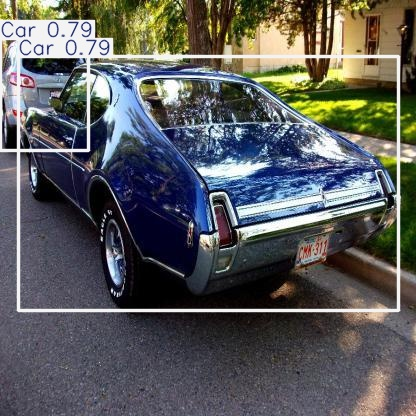

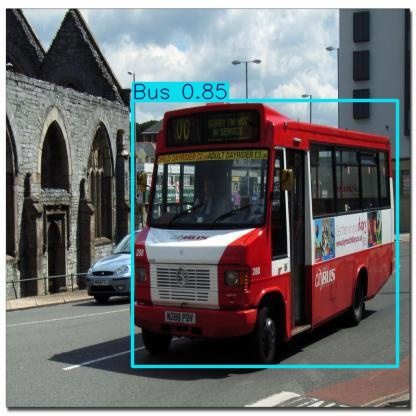

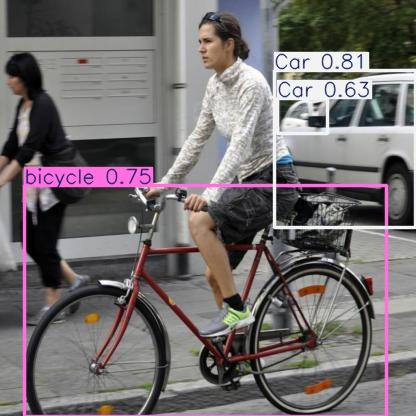

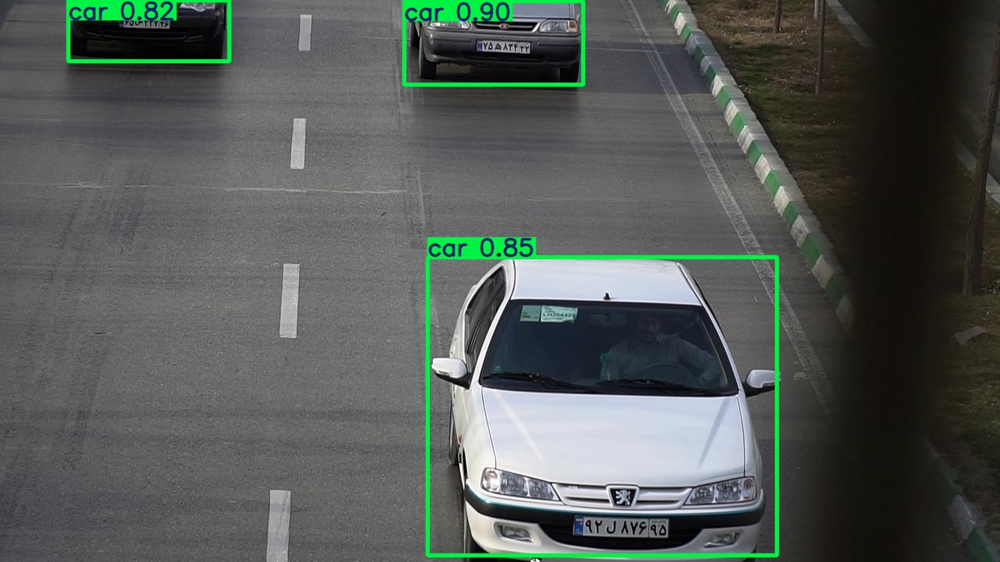

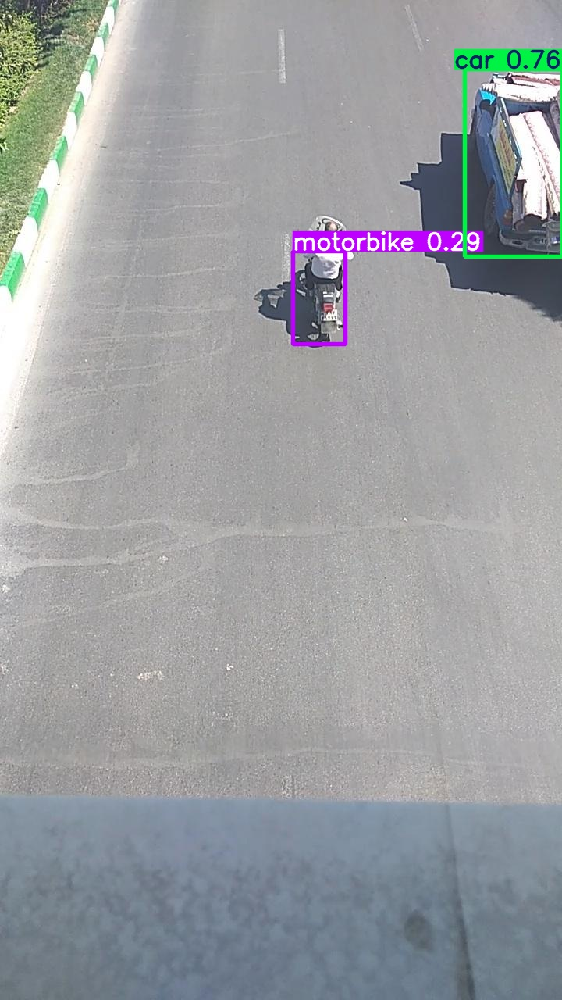

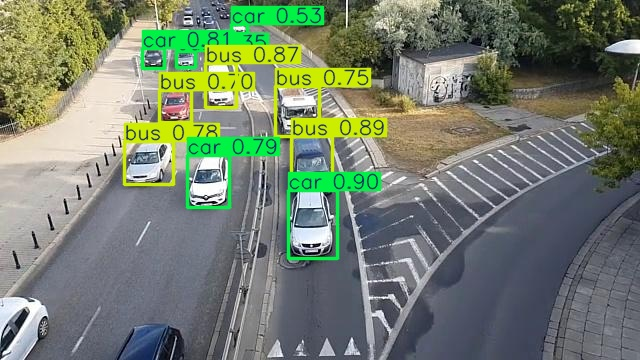

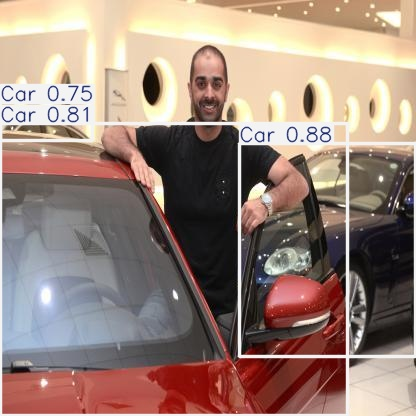

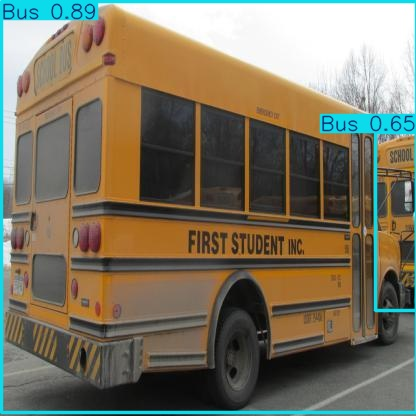

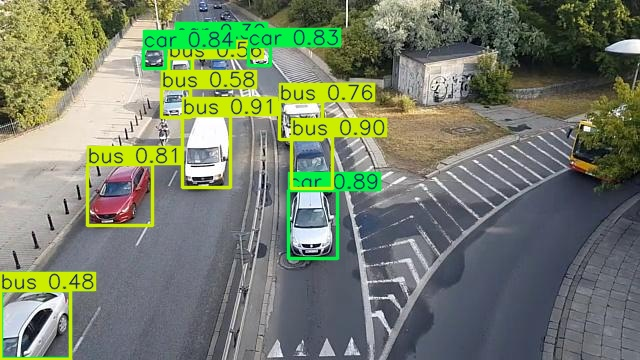

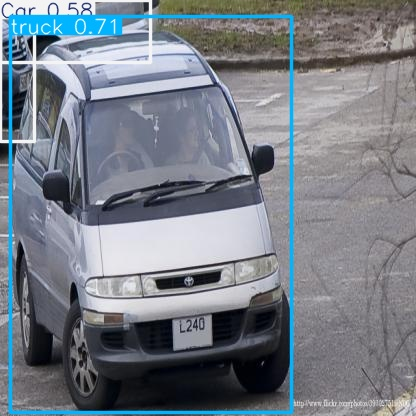

In [ ]:
for image_path in glob.glob('runs/detect/predict/*.jpg')[:10]:
  display(Image(filename=image_path, width=400))
  print('\n')

In [11]:
!yolo task=detect mode=predict model='runs/detect/train/weights/best.pt' \
      source='traffic_test.mp4' \
      save=True

Ultralytics 8.3.224 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,007,793 parameters, 0 gradients, 8.1 GFLOPs

video 1/1 (frame 1/513) /content/traffic_test.mp4: 384x640 (no detections), 45.3ms
video 1/1 (frame 2/513) /content/traffic_test.mp4: 384x640 3 Cars, 1 car, 9.2ms
video 1/1 (frame 3/513) /content/traffic_test.mp4: 384x640 4 Cars, 1 bus, 2 cars, 8.9ms
video 1/1 (frame 4/513) /content/traffic_test.mp4: 384x640 4 Cars, 1 bus, 2 cars, 9.0ms
video 1/1 (frame 5/513) /content/traffic_test.mp4: 384x640 1 Bus, 3 Cars, 2 cars, 8.8ms
video 1/1 (frame 6/513) /content/traffic_test.mp4: 384x640 1 Bus, 3 Cars, 2 cars, 8.6ms
video 1/1 (frame 7/513) /content/traffic_test.mp4: 384x640 1 Bus, 3 Cars, 2 cars, 8.6ms
video 1/1 (frame 8/513) /content/traffic_test.mp4: 384x640 1 Bus, 2 Cars, 3 cars, 9.5ms
video 1/1 (frame 9/513) /content/traffic_test.mp4: 384x640 1 Bus, 3 Cars, 3 cars, 8.8ms
video 1/1 (frame 10/513) /content/traffic_test.mp4: 384x6

In [19]:
!ffmpeg -i runs/detect/predict2/traffic_test.avi -vcodec libx264 runs/detect/predict2/traffic_test.mp4

ffmpeg version 4.4.2-0ubuntu0.22.04.1 Copyright (c) 2000-2021 the FFmpeg developers
  built with gcc 11 (Ubuntu 11.2.0-19ubuntu1)
  configuration: --prefix=/usr --extra-version=0ubuntu0.22.04.1 --toolchain=hardened --libdir=/usr/lib/x86_64-linux-gnu --incdir=/usr/include/x86_64-linux-gnu --arch=amd64 --enable-gpl --disable-stripping --enable-gnutls --enable-ladspa --enable-libaom --enable-libass --enable-libbluray --enable-libbs2b --enable-libcaca --enable-libcdio --enable-libcodec2 --enable-libdav1d --enable-libflite --enable-libfontconfig --enable-libfreetype --enable-libfribidi --enable-libgme --enable-libgsm --enable-libjack --enable-libmp3lame --enable-libmysofa --enable-libopenjpeg --enable-libopenmpt --enable-libopus --enable-libpulse --enable-librabbitmq --enable-librubberband --enable-libshine --enable-libsnappy --enable-libsoxr --enable-libspeex --enable-libsrt --enable-libssh --enable-libtheora --enable-libtwolame --enable-libvidstab --enable-libvorbis --enable-libvpx --enab

In [20]:
display(Video('runs/detect/predict2/traffic_test.mp4', embed=True, width=600))